# LSTM - vanilla

In [116]:
best_model = "best_model17.pt"

# Loading and Data Analysis

In [117]:
import os

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch_geometric.data import Data, Batch
import tqdm

In [118]:
train_file = np.load('./cse-251-b-2025/train.npz')

train_data = train_file['data']
print("train_data's shape", train_data.shape)
test_file = np.load('./cse-251-b-2025/test_input.npz')

test_data = test_file['data']
print("test_data's shape", test_data.shape)

train_data's shape (10000, 50, 110, 6)
test_data's shape (2100, 50, 50, 6)


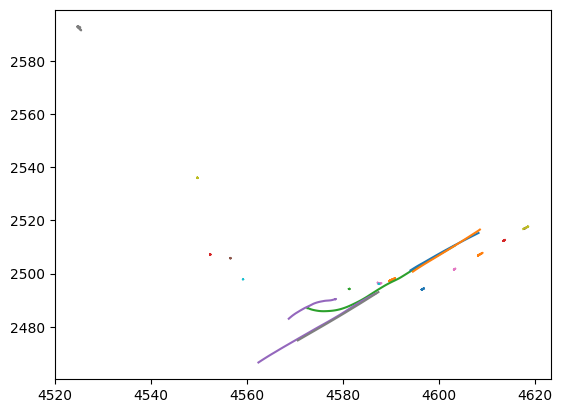

In [340]:
# plot one
import matplotlib.pyplot as plt

data_matrix = train_data[6027]

for i in range(data_matrix.shape[0]):
    xs = data_matrix[i, :, 0]
    ys = data_matrix[i, :, 1]
    # trim all zeros
    xs = xs[xs != 0]
    ys = ys[ys != 0]
    # plot each line going from transparent to full
    plt.plot(xs, ys)

plt.show()

0
0
0
6
1
0
0
0
0
0


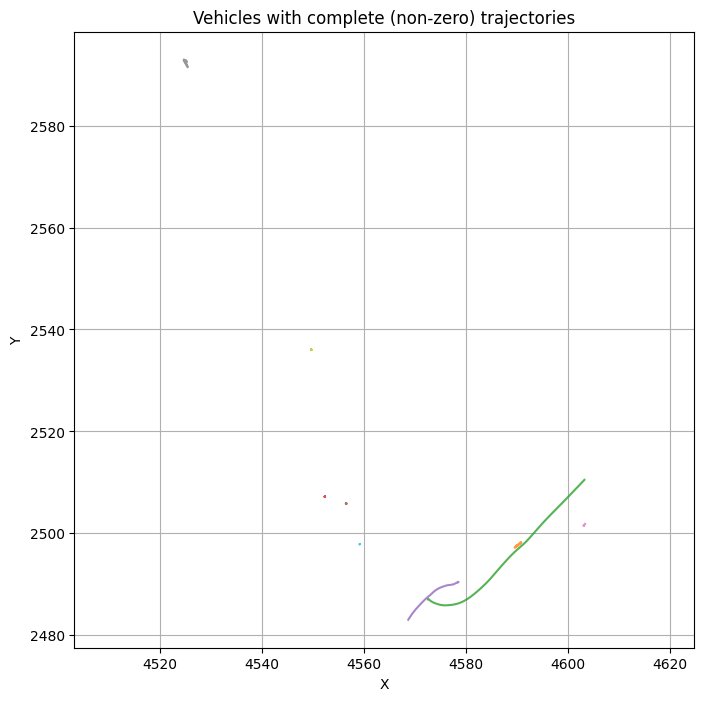

In [346]:
import matplotlib.pyplot as plt
import numpy as np

plt.figure(figsize=(8, 8))

for i in range(data_matrix.shape[0]):
    obj_type = int(data_matrix[i, 0, 5])  # object type at t=0
    # if obj_type != 0:
    #     continue  # skip non-vehicles
    # if i != 1:
    #     continue

    xy = data_matrix[i, :, :2]  # shape: (110, 2)
    
    # Check for any zero positions in x or y
    if np.any(np.all(xy == 0, axis=1)):
        continue  # skip if any (x, y) == (0, 0)
    
    # Plot full trajectory
    xs, ys = xy[:, 0], xy[:, 1]
    plt.plot(xs, ys, alpha=0.8)
    print(obj_type)

plt.title("Vehicles with complete (non-zero) trajectories")
plt.xlabel("X")
plt.ylabel("Y")
plt.axis('equal')
plt.grid(True)
plt.show()


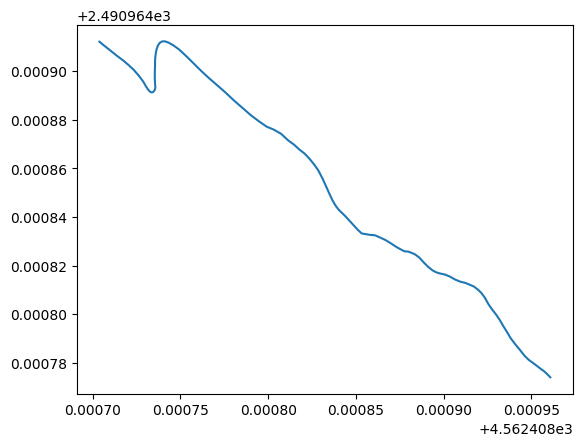

In [342]:
# plot one

# for i in range(data_matrix.shape[0]):
for i in range(1):
    xs = data_matrix[i, :, 0]
    ys = data_matrix[i, :, 1]
    # trim all zeros
    xs = xs[xs != 0]
    ys = ys[ys != 0]
    # plot each line going from transparent to full
    plt.plot(xs, ys)

plt.show()

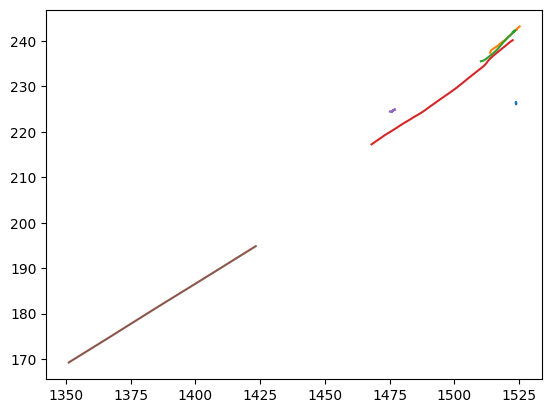

In [288]:
# for i in range(data_matrix.shape[0]):
# for i in range(1):
idxs = [16, 30, 28, 13, 20, 0]
# idxs = [0]
# idxs = [0, 13]

for i in idxs:
    xs = data_matrix[i, :, 0]
    ys = data_matrix[i, :, 1]
    # trim all zeros
    xs = xs[xs != 0]
    ys = ys[ys != 0]
    # plot each line going from transparent to full
    plt.plot(xs, ys)

plt.show()

## Closest objects to ego in a scene

In [121]:
import numpy as np

def get_closest_vehicle_indices(scene, top_k=20):
    """
    scene: numpy array of shape (50, 110, 6) for one scene
    top_k: how many closest agents to select

    Returns:
        top_k_indices: list of agent indices
        contains_ego: whether index 0 is in top_k_indices
        object_types: object types of top-k agents
    """
    # Historical trajectory (first 50 steps)
    hist = scene[:, :50, :]
    
    # Ego position at t=49
    ego_pos = hist[0, 49, :2]

    # Get all agent positions at t=49
    agent_positions = hist[:, 49, :2]

    # Compute L2 distances to ego
    distances = np.linalg.norm(agent_positions - ego_pos, axis=1)

    # Sort agents by distance
    top_k_indices = distances.argsort()[:top_k]  # returns agent indices

    # Get object types for top-k
    object_types = scene[top_k_indices, 0, 5]  # object_type at t=0

    contains_ego = 0 in top_k_indices

    return top_k_indices.tolist(), contains_ego, object_types.tolist()

In [122]:
scene = train_data[123]  # or any index
top_k_indices, contains_ego, obj_types = get_closest_vehicle_indices(scene, top_k=20)

print("Top-k closest agent indices:", top_k_indices)
print("Ego included:", contains_ego)
print("Their object types:", obj_types)

Top-k closest agent indices: [0, 4, 8, 12, 11, 24, 6, 1, 9, 10, 18, 16, 20, 14, 21, 3, 2, 26, 7, 17]
Ego included: True
Their object types: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


## Unique number of closest objects to ego in a scene

In [224]:
import numpy as np
from collections import Counter

# def object_type_stats_topk(data, top_k=20, ignore_types={}):
def object_type_stats_topk(data, top_k=20, ignore_types={5, 6, 7}):
    """
    Computes min, max, mean, and counts of unique object types among top_k
    closest agents to ego (excluding ignored types).
    
    Parameters:
        data: np.ndarray of shape (N, 50, 110, 6)
        top_k: int
        ignore_types: set of int
    
    Returns:
        stats: dict with stats and histogram of scene counts by unique type count
    """
    per_scene_counts = []

    for scene in data:
        positions = scene[:, 49, :2]  # (50, 2)
        ego_pos = positions[0]
        dists = np.linalg.norm(positions - ego_pos, axis=1)
        top_k_indices = np.argsort(dists)[:top_k]

        object_types = scene[top_k_indices, 0, 5].astype(int)
        filtered_types = [t for t in object_types if t not in ignore_types]
        unique_count = len(set(filtered_types))
        per_scene_counts.append(unique_count)

    counts_hist = dict(Counter(per_scene_counts))

    return {
        'min': int(np.min(per_scene_counts)),
        'max': int(np.max(per_scene_counts)),
        'mean': float(np.mean(per_scene_counts)),
        'histogram': counts_hist,
        'per_scene_counts': per_scene_counts,
    }

stats = object_type_stats_topk(train_data, top_k=5)

print(f"Min unique types per scene: {stats['min']}")
print(f"Max unique types per scene: {stats['max']}")
print(f"Mean unique types per scene: {stats['mean']:.2f}")

print("\nHistogram of unique type counts:")
for num_types, num_scenes in sorted(stats['histogram'].items()):
    print(f"{num_types} unique types: {num_scenes} scenes")


Min unique types per scene: 1
Max unique types per scene: 4
Mean unique types per scene: 1.21

Histogram of unique type counts:
1 unique types: 8021 scenes
2 unique types: 1816 scenes
3 unique types: 157 scenes
4 unique types: 6 scenes


In [212]:
import numpy as np
from collections import Counter, defaultdict

def object_type_stats_topk(data, top_k=20, ignore_types={5, 6, 7}):
    """
    Computes stats on unique object types in top_k closest agents to ego,
    ignoring specified object types (e.g., 5, 6, 7).

    Parameters:
        data: np.ndarray of shape (N, 50, 110, 6)
        top_k: number of closest agents to consider
        ignore_types: set of object_type ints to exclude

    Returns:
        summary: dict with:
            - min / max / mean unique type count
            - histogram of unique type counts
            - frequency of each object_type (after filtering)
    """
    per_scene_counts = []
    object_type_freq = Counter()
    type_combinations = Counter()

    for scene in data:
        positions = scene[:, 49, :2]
        ego_pos = positions[0]
        dists = np.linalg.norm(positions - ego_pos, axis=1)
        top_k_indices = np.argsort(dists)[:top_k]

        # Get object types
        object_types = scene[top_k_indices, 0, 5].astype(int)

        # Filter
        filtered = [t for t in object_types if t not in ignore_types]
        unique_types = set(filtered)

        # Update stats
        per_scene_counts.append(len(unique_types))
        object_type_freq.update(unique_types)
        type_combinations.update([tuple(sorted(unique_types))])

    return {
        'min': int(np.min(per_scene_counts)),
        'max': int(np.max(per_scene_counts)),
        'mean': float(np.mean(per_scene_counts)),
        'histogram': dict(Counter(per_scene_counts)),
        'object_type_frequency': dict(object_type_freq),
        'type_combinations': dict(type_combinations)
    }

stats = object_type_stats_topk(train_data, top_k=5)

print(f"Min unique types per scene: {stats['min']}")
print(f"Max unique types per scene: {stats['max']}")
print(f"Mean unique types per scene: {stats['mean']:.2f}\n")

print("Histogram of unique type counts:")
for k, v in sorted(stats['histogram'].items()):
    print(f"{k} unique types: {v} scenes")

print("\nObject type appearance frequency across scenes:")
object_type_names = {
    0: 'vehicle', 1: 'pedestrian', 2: 'motorcyclist', 3: 'cyclist', 4: 'bus',
    5: 'static', 6: 'background', 7: 'construction', 8: 'riderless_bicycle', 9: 'unknown'
}
for obj_type, count in sorted(stats['object_type_frequency'].items()):
    name = object_type_names.get(obj_type, f"type {obj_type}")
    print(f"{name} (type {obj_type}): {count} scenes")

print("\nCommon object type combinations:")
for combo, count in sorted(stats['type_combinations'].items(), key=lambda x: -x[1])[:10]:
    labels = [object_type_names.get(t, str(t)) for t in combo]
    print(f"{labels}: {count} scenes")

Min unique types per scene: 1
Max unique types per scene: 4
Mean unique types per scene: 1.21

Histogram of unique type counts:
1 unique types: 8021 scenes
2 unique types: 1816 scenes
3 unique types: 157 scenes
4 unique types: 6 scenes

Object type appearance frequency across scenes:
vehicle (type 0): 10000 scenes
pedestrian (type 1): 1304 scenes
motorcyclist (type 2): 92 scenes
cyclist (type 3): 202 scenes
bus (type 4): 298 scenes
riderless_bicycle (type 8): 247 scenes
unknown (type 9): 5 scenes

Common object type combinations:
['vehicle']: 8021 scenes
['vehicle', 'pedestrian']: 1159 scenes
['vehicle', 'bus']: 248 scenes
['vehicle', 'riderless_bicycle']: 181 scenes
['vehicle', 'cyclist']: 153 scenes
['vehicle', 'motorcyclist']: 71 scenes
['vehicle', 'pedestrian', 'riderless_bicycle']: 48 scenes
['vehicle', 'pedestrian', 'bus']: 38 scenes
['vehicle', 'pedestrian', 'cyclist']: 34 scenes
['vehicle', 'pedestrian', 'motorcyclist']: 19 scenes


## Focal Agent

In [220]:
def get_focal_agent_index(scene, ignore_types={5, 6, 7}):
    """
    Returns the index of the focal agent relative to the ego (agent 0).
    Focal = closest non-ego, dynamic agent.
    """
    ego_pos = scene[0, 49, :2]
    object_types = scene[:, 0, 5].astype(int)

    # Exclude ego (index 0) and unwanted types
    valid_mask = np.arange(scene.shape[0]) != 0
    valid_mask &= ~np.isin(object_types, list(ignore_types))

    positions = scene[:, 49, :2]
    distances = np.linalg.norm(positions - ego_pos, axis=1)

    # Mask invalid distances
    distances[~valid_mask] = np.inf

    focal_idx = np.argmin(distances)
    if distances[focal_idx] == np.inf:
        return None  # no valid focal agent
    return focal_idx

scene = train_data[0]
focal = get_focal_agent_index(scene)
if focal is not None:
    print(f"Focal agent index: {focal}, type: {int(scene[focal, 0, 5])}")
else:
    print("No valid focal agent found.")


Focal agent index: 13, type: 0


## Ego vehicle type

In [123]:
import numpy as np

def check_ego_object_types(dataset):
    """
    dataset: numpy array of shape (N, 50, 110, 6)
             where N is number of scenes
    Returns:
        unique_types: sorted list of unique object types seen for ego
        type_counts: dictionary of how often each type appears
    """
    ego_types = dataset[:, 0, 0, 5]  # get object_type of agent 0 at t=0 for all scenes

    unique_types, counts = np.unique(ego_types, return_counts=True)
    type_counts = dict(zip(unique_types.astype(int), counts))

    return unique_types.astype(int).tolist(), type_counts


unique_ego_types, counts = check_ego_object_types(train_data)

print("Unique ego object types:", unique_ego_types)
print("Counts by type:", counts)


Unique ego object types: [0]
Counts by type: {np.int64(0): np.int64(10000)}


## Check if agents of types 5, 6, 7 move at all

In [135]:
import numpy as np


def get_valid_timesteps(traj):
    """
    traj: np.ndarray of shape (T, 2), a single agent's (x, y) trajectory
    Returns:
        valid_mask: np.ndarray of shape (T,), bool mask where x, y != 0
    """
    return ~np.all(traj == 0, axis=1)

def max_displacement(traj):
    """Returns max distance the agent moves from its initial position"""
    displacements = np.linalg.norm(traj - traj[0], axis=1)
    return np.max(displacements)

def check_static_agent_movement(data):
    """
    data: numpy array of shape (N, 50, 110, 6)
    Returns:
        movement_summary: dict mapping object_type (5,6,7) → (num_agents, num_moving)
    """
    movement_summary = {5: [0, 0], 6: [0, 0], 7: [0, 0]}  # {type: [total_count, moving_count]}

    print(f'data shape: {data.shape}')
    
    for scene in data:
        print(f'scene shape: {scene.shape}')
        # scene: shape (50, 110, 6)
        for agent in scene:
            
            obj_type = int(agent[0, 5])
            if obj_type in [5, 6, 7]:
                print(f'agent shape: {agent.shape}')
                movement_summary[obj_type][0] += 1  # count total agents

                # Get trajectory: (110, 2)
                traj = agent[:, :2]
                print(f'traj shape: {traj.shape}')
                
                # Check if all positions are the same
                # if not np.allclose(traj[0], traj, atol=1e-3):
                valid = get_valid_timesteps(traj)
                valid_traj = traj[valid]
                
                # displacement = max_displacement(agent[:, :2])
                if np.linalg.norm(valid_traj - valid_traj[0]) > 2:  # meters
                    print("Unusually mobile 'static' agent")

                    movement_summary[obj_type][1] += 1  # count moving ones
                    print(f'movement!!! agent: {obj_type}')
                    print(f'traj[0]: {traj[0]}')
                    print(f'traj: {traj}')

    return movement_summary

summary = check_static_agent_movement(train_data)

for obj_type in summary:
    total, moving = summary[obj_type]
    print(f"Object Type {obj_type}: {moving}/{total} moved ({100 * moving / total:.2f}%)")


data shape: (10000, 50, 110, 6)
scene shape: (50, 110, 6)
scene shape: (50, 110, 6)
agent shape: (110, 6)
traj shape: (110, 2)
Unusually mobile 'static' agent
movement!!! agent: 5
traj[0]: [3159.40658462 1702.06793403]
traj: [[3159.40658462 1702.06793403]
 [3159.46362261 1702.017021  ]
 [3159.50820027 1701.98539008]
 [3159.54960787 1701.96298776]
 [3159.6035158  1701.92764809]
 [3159.66422213 1701.88476321]
 [3159.71466849 1701.84999146]
 [3159.76170795 1701.81289438]
 [3159.83370261 1701.74871973]
 [3159.9074899  1701.67994352]
 [3159.9643106  1701.61835951]
 [3160.02731721 1701.55456329]
 [3160.08487077 1701.49677944]
 [3160.13754673 1701.44133034]
 [3160.18435433 1701.39353436]
 [3160.23488444 1701.34353079]
 [3160.28068903 1701.29715982]
 [3160.3250605  1701.24460529]
 [3160.39518098 1701.16152085]
 [3160.4552899  1701.09284162]
 [3160.48467291 1701.0679573 ]
 [3160.49891826 1701.05685131]
 [3160.51046068 1701.04164348]
 [3160.51530269 1701.03528778]
 [3160.51239956 1701.03678816]


In [185]:
import numpy as np

def get_valid_timesteps(traj):
    """
    traj: np.ndarray of shape (T, 2), a single agent's (x, y) trajectory
    Returns:
        valid_mask: np.ndarray of shape (T,), bool mask where x, y != 0
    """
    return ~np.all(traj == 0, axis=1)

def max_displacement(traj):
    """
    Returns max distance from the initial valid position
    traj: np.ndarray of shape (T, 2)
    """
    if len(traj) == 0:
        return 0.0
    displacements = np.linalg.norm(traj - traj[0], axis=1)
    return np.max(displacements)

def check_static_agent_movement(data, threshold=10.0):
    """
    data: numpy array of shape (N, 50, 110, 6)
    Returns:
        movement_summary: dict mapping object_type (5,6,7) → (num_agents, num_moving)
    """
    movement_summary = {5: [0, 0], 6: [0, 0], 7: [0, 0]}  # {type: [total_count, moving_count]}

    for i, scene in enumerate(data):
        # scene: shape (50, 110, 6)
        for j, agent in enumerate(scene):
            obj_type = int(agent[0, 5])
            if obj_type in [5, 6, 7]:
                movement_summary[obj_type][0] += 1  # total

                traj = agent[:, :2]  # (110, 2)
                valid = get_valid_timesteps(traj)
                valid_traj = traj[valid]

                # Check if displacement exceeds threshold
                if 10 < max_displacement(valid_traj) < 30:
                    movement_summary[obj_type][1] += 1  # moving
                    print(f'scene: {i} === agent: {j}')
                    print(f'agent type: {obj_type}')
                    print(f'disp: {max_displacement(valid_traj)}')
                    print(f'traj[0]: {valid_traj[0]}')
                    # print(f'traj: {valid_traj}')

    return movement_summary

summary = check_static_agent_movement(train_data)

for obj_type in summary:
    total, moving = summary[obj_type]
    print(f"Object Type {obj_type}: {moving}/{total} moved ({100 * moving / total:.2f}%)")


scene: 59 === agent: 37
agent type: 7
disp: 16.820831041035756
traj[0]: [5550.37166377 1824.38869606]
scene: 68 === agent: 1
agent type: 6
disp: 13.462712605376987
traj[0]: [4526.27266111 -188.61890928]
scene: 447 === agent: 9
agent type: 5
disp: 10.035863796588403
traj[0]: [-1494.15231592  1617.58410611]
scene: 455 === agent: 4
agent type: 7
disp: 18.022823993609087
traj[0]: [2718.13910046 1311.30408444]
scene: 610 === agent: 27
agent type: 5
disp: 15.382117175588137
traj[0]: [-1641.02382752  1774.99309227]
scene: 657 === agent: 9
agent type: 6
disp: 10.531404965697087
traj[0]: [11481.45812373  4848.08254692]
scene: 735 === agent: 1
agent type: 6
disp: 16.382228654640382
traj[0]: [3820.44005376 2326.5663037 ]
scene: 763 === agent: 3
agent type: 7
disp: 24.997393038496437
traj[0]: [3127.62210471 1839.26498301]
scene: 765 === agent: 1
agent type: 6
disp: 14.770199457445845
traj[0]: [10450.75870168  4909.12900481]
scene: 869 === agent: 36
agent type: 6
disp: 10.139225719022276
traj[0]: [

In [ ]:
import numpy as np

def filter_valid_agents(hist, future, min_hist_steps=5, min_future_steps=5):
    """
    Filters agents based on valid (non-zero) history and future trajectories.
    
    Parameters:
        hist: np.ndarray (agents, hist_len, features) — typically (50, 50, 6)
        future: np.ndarray (agents, future_len, features) — typically (50, 60, 6)
        min_hist_steps: int — minimum non-zero timesteps required in history
        min_future_steps: int — minimum non-zero timesteps required in future

    Returns:
        hist_filtered: (valid_agents, hist_len, features)
        future_filtered: (valid_agents, future_len, features)
        valid_mask: boolean array (agents,) — True for kept agents
    """

    def count_nonzero_steps(traj):
        # traj: (timesteps, 2)
        valid = ~np.all(traj[:, :2] == 0, axis=1)
        return np.sum(valid)

    num_agents = hist.shape[0]
    valid_mask = np.zeros(num_agents, dtype=bool)

    for i in range(num_agents):
        hist_steps = count_nonzero_steps(hist[i])
        future_steps = count_nonzero_steps(future[i])
        if hist_steps >= min_hist_steps and future_steps >= min_future_steps:
            valid_mask[i] = True

    return hist[valid_mask], future[valid_mask], valid_mask

# scene = self.data[idx]  # (50, 110, 6)
# hist = scene[:, :50, :]    # (agents, 50, 6)
# future = scene[:, 50:, :]  # (agents, 60, 6)

# hist, future, valid_mask = filter_valid_agents(hist, future)

## Appear-Disappear-Reappear Objects

In [196]:
import numpy as np

def detect_reappearing_agents(data):
    """
    Checks for agents that have non-zero (x, y), then zeros, then non-zero again.
    
    Parameters:
        data: numpy array of shape (N, 50, 110, 6)
    
    Returns:
        List of (scene_idx, agent_idx) where this behavior is detected
    """
    reappearing_agents = []

    for scene_idx, scene in enumerate(data):
        for agent_idx, agent in enumerate(scene):  # shape (110, 6)
            traj = agent[:, :2]  # (110, 2)
            valid_mask = ~np.all(traj == 0, axis=1)  # (110,) boolean
            # print(valid_mask)
            # break

            # Look for: True → False → True pattern
            str_mask = ''.join(valid_mask.astype(int).astype(str))
            # print(str_mask)
            if '101' in str_mask:
                reappearing_agents.append((scene_idx, agent_idx))
        # break

    return reappearing_agents

reappearing = detect_reappearing_agents(train_data)

print(f"Found {len(reappearing)} reappearing agents.")
for scene_idx, agent_idx in reappearing[:5]:
    print(f"Scene {scene_idx}, Agent {agent_idx} reappears after disappearing.")


Found 0 reappearing agents.


## Ego All Zeros?

In [197]:
import numpy as np

def check_ego_all_zeros(data):
    """
    data: np.ndarray of shape (N, 50, 110, 6)
    Returns: list of scene indices where ego is all zeros
    """
    bad_indices = []
    for i, scene in enumerate(data):
        ego_traj = scene[0, :, :2]  # ego's (x, y) trajectory (110, 2)
        if np.allclose(ego_traj, 0.0, atol=1e-5):
            bad_indices.append(i)
    return bad_indices

bad_scenes = check_ego_all_zeros(train_data)
print(f"{len(bad_scenes)} scenes where ego has all-zero trajectory.")

0 scenes where ego has all-zero trajectory.


## Ego any zeros?

In [198]:
def check_ego_has_any_zeros(data):
    """
    data: np.ndarray of shape (N, 50, 110, 6)
    Returns: list of scene indices where ego has any (x, y) == 0
    """
    bad_indices = []
    for i, scene in enumerate(data):
        ego_traj = scene[0, :, :2]  # (110, 2)
        zero_mask = np.all(ego_traj == 0, axis=1)  # shape: (110,)
        if np.any(zero_mask):
            bad_indices.append(i)
    return bad_indices

bad_scenes = check_ego_has_any_zeros(train_data)
print(f"Ego has (x, y) == 0 at some point in {len(bad_scenes)} scenes.")

Ego has (x, y) == 0 at some point in 0 scenes.


# Data Loaders

In [360]:
class TrajectoryDatasetTrain(Dataset):
    def __init__(self, data, scale=10.0, augment=True, top_k=5):
        self.data = data  # shape (N, 50, 110, 6)
        self.scale = scale
        self.augment = augment
        self.top_k = top_k

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        scene = self.data[idx]  # (50 agents, 110 timesteps, 6 features)

        hist = scene[:, :50, :].copy()    # (50, 50, 6)
        future = scene[:, 50:, :].copy()  # (50, 60, 6)

        # Data augmentation (rotate + flip)
        if self.augment:
            if np.random.rand() < 0.5:
                theta = np.random.uniform(-np.pi, np.pi)
                R = np.array([[np.cos(theta), -np.sin(theta)],
                              [np.sin(theta),  np.cos(theta)]], dtype=np.float32)
                hist[..., :2] = hist[..., :2] @ R
                hist[..., 2:4] = hist[..., 2:4] @ R
                future[..., :2] = future[..., :2] @ R
                future[..., 2:4] = future[..., 2:4] @ R
            if np.random.rand() < 0.5:
                hist[..., 0] *= -1
                hist[..., 2] *= -1
                future[..., 0] *= -1
                future[..., 2] *= -1

        # Use ego position at t=49 as origin
        origin = hist[0, 49, :2].copy()
        hist[..., :2] -= origin
        future[..., :2] -= origin

        # Normalize
        hist[..., :4] /= self.scale
        future[..., :4] /= self.scale

        # Filter agents of type 0
        object_types = hist[:, 0, 5]
        is_vehicle = (object_types == 0)

        # Filter agents with no (x, y) == 0 in hist or future
        hist_xy = hist[:, :, :2]
        future_xy = future[:, :, :2]
        has_zero_hist = np.any(np.all(hist_xy == 0, axis=-1), axis=1)
        has_zero_future = np.any(np.all(future_xy == 0, axis=-1), axis=1)
        valid_mask = is_vehicle & ~has_zero_hist & ~has_zero_future

        valid_hist = hist[valid_mask]
        valid_future = future[valid_mask]

        if len(valid_hist) == 0:
            # fallback to ego only if no valid agent
            valid_hist = hist[[0]]
            valid_future = future[[0]]
        else:
            # Sort by distance to ego at t=49
            dists = np.linalg.norm(valid_hist[:, 49, :2], axis=1)
            top_k_indices = np.argsort(dists)[:self.top_k]
            valid_hist = valid_hist[top_k_indices]
            valid_future = valid_future[top_k_indices]

        return Data(
            x=torch.tensor(valid_hist, dtype=torch.float32),     # shape (k, 50, 6)
            y=torch.tensor(valid_future, dtype=torch.float32),   # shape (k, 60, 6)
            origin=torch.tensor(origin, dtype=torch.float32).unsqueeze(0),
            scale=torch.tensor(self.scale, dtype=torch.float32),
        )
    

class TrajectoryDatasetTest(Dataset):
    def __init__(self, data, scale=10.0):
        """
        data: Shape (N, 50, 110, 6) Testing data
        scale: Scale for normalization (suggested to use 10.0 for Argoverse 2 data)
        """
        self.data = data
        self.scale = scale

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        # Testing data only contains historical trajectory
        scene = self.data[idx]  # (50, 50, 6)
        hist = scene.copy()
        
        origin = hist[0, 49, :2].copy()
        hist[..., :2] = hist[..., :2] - origin
        hist[..., :4] = hist[..., :4] / self.scale

        data_item = Data(
            x=torch.tensor(hist, dtype=torch.float32),
            origin=torch.tensor(origin, dtype=torch.float32).unsqueeze(0),
            scale=torch.tensor(self.scale, dtype=torch.float32),
        )
        
        # print(f'test - x shape: {data_item.x.shape}')
        
        return data_item

In [361]:
torch.manual_seed(251)
np.random.seed(42)

scale = 7.0
batch_size = 32

N = len(train_data)
val_size = int(0.1 * N)
train_size = N - val_size

train_dataset = TrajectoryDatasetTrain(train_data[:train_size], scale=scale, augment=True)
val_dataset = TrajectoryDatasetTrain(train_data[train_size:], scale=scale, augment=False)

train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn=lambda x: Batch.from_data_list(x))
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, collate_fn=lambda x: Batch.from_data_list(x))

# Set device for training speedup
if torch.backends.mps.is_available():
    device = torch.device('mps')
    print("Using Apple Silicon GPU")
elif torch.cuda.is_available():
    device = torch.device('cuda')
    print("Using CUDA GPU")
else:
    device = torch.device('cpu')

Using Apple Silicon GPU


# LSTM

In [362]:
class AutoRegressiveLSTM(nn.Module):
    def __init__(self, input_dim=5, hidden_dim=1024, output_dim=5, num_layers=1, future_steps=60, object_type=0):
        super().__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers
        self.future_steps = future_steps

        # Encoder: takes in past trajectory
        self.encoder = nn.LSTM(input_size=input_dim, hidden_size=hidden_dim, num_layers=num_layers, batch_first=True)

        # Decoder: predicts future positions one step at a time
        self.decoder = nn.LSTM(input_size=5, hidden_size=hidden_dim, num_layers=num_layers, batch_first=True)
        self.out = nn.Linear(hidden_dim, output_dim)

    def forward(self, data, forcing_ratio = 0.5):
    # def forward(self, data):
        # print(f'x: {data.x.shape}')
        # print(f'y: {data.y.shape}')
        
        batch_size = data.num_graphs
        x = data.x.view(batch_size, -1, 50, 6)  # (batch, num_agents, 50, 6)
        y = data.y.view(batch_size, -1, 60, 6)
        
        # x = data.x  
        # x = x.reshape(-1, 50, 50, 6)  # (batch, 50, 50, 6), ego only
        # y = data.y.reshape(-1, 50, 60, 6)  # (batch, 50, 50, 6), ego only
        
        # print(f'x2: {x.shape}')
        # print(f'y2: {y.shape}')
        
        # Filter only one type of vehicle
        # object_type = x[:, :, 0, 5]  # shape: (batch, agents)
        # vehicle_mask = object_type == 0  # boolean mask
        # print(f'object_type: {object_type.shape}')
        # print(f'vehicle_mask: {vehicle_mask.shape}')

        # Mask and select features
        vehicle_trajectories_hist = []
        vehicle_trajectories_future = []
        
        ego_indices = []
        cumulative_index = 0
        
        for b in range(x.shape[0]):  # for each batch
            mask = vehicle_mask[b]
            x_v = x[b][mask]  # (num_vehicles, 50, 6)
            vehicle_trajectories_hist.append(x_v[..., :5])  # keep only 5 features
            
            y_v = y[b][mask]  # (num_vehicles, 50, 6)
            vehicle_trajectories_future.append(y_v[..., :5])  # keep only 5 features
            
            # print(f'vehicle_trajectories: {vehicle_trajectories}')
            # break
            
            # Track ego!
            # Find where ego (index 0) is in the filtered vehicles
            index_in_masked = torch.nonzero(mask).squeeze()
            ego_in_filtered = (index_in_masked == 0).nonzero().squeeze()

            # Store global index (across batch)
            ego_indices.append(cumulative_index + ego_in_filtered.item())
            cumulative_index += mask.sum().item()

        # Optionally, stack all vehicles across all batches for shared LSTM
        x = torch.cat(vehicle_trajectories_hist, dim=0)  # shape: (total_vehicles, 50, 5)
        # print(f'final x: {x.shape}')
        
        y = torch.cat(vehicle_trajectories_future, dim=0)  # shape: (total_vehicles, 60, 5)
        # print(f'final y: {y.shape}')
        
        future = y # (total_vehicles, 60, 5)
        
        # batch_size = x.size(0)
        
        # if self.training:
        #     future = data.y.view(batch_size, 60, 5) # (batch, 60, 5)

        # Encode past
        _, (hidden, cell) = self.encoder(x)

        # Initialize decoder input with last observed position
        decoder_input = x[:, -1, :5].unsqueeze(1)  # (batch, 1, 5)
        
        # print("decoder_input.shape - initial", decoder_input.shape)  # should be (batch, 1, 2)

        outputs = []

        for t in range(self.future_steps):
            output, (hidden, cell) = self.decoder(decoder_input, (hidden, cell)) # (batch, 1, hidden_dim)
            # print(f'decoder output: {output.shape}')
            pred = self.out(output)  # (batch, 1, 5)
            # print(f'pred output: {pred.shape}')
            outputs.append(pred)
            # print(f'pred outputs: {len(outputs)}')

            # TODO: remove forcing ratio?
            if self.training and random.random() < forcing_ratio:
                # print('teacher forcing')
                # print(f'future: {future.shape}') # (1534, 60, 5)
                # print(f'future[:, t].unsqueeze(1): {future[:, t].unsqueeze(1).shape}') # (1534, 1, 5)
                decoder_input = future[:, t].unsqueeze(1)  # ground truth
                # print("decoder_input.shape - teacher forcing", decoder_input.shape)  # should be (batch, 1, 2)
            else:
                # print('autoreg')
                # print(f'pred: {pred.shape}')
                decoder_input = pred.detach()  # predicted output as next input
                # print("decoder_input.shape - autoreg", decoder_input.shape)  # should be (batch, 1, 2)

        # outputs = torch.cat(outputs, dim=1)  # (batch, 60, 2)
        # print(f'outputs: {len(outputs)}')
        outputs = torch.cat(outputs, dim=1)[:, :, :2]  # (batch, 60, 2)
        # print(f'output of fwd fn- all: {outputs.shape}')
        
        xy_outputs = outputs[:, :, :2]       # (total_vehicles, 60, 2)
        
        # print(f'output of fwd fn- all (x and y): {outputs.shape}')
        
        # Now extract only ego predictions
        ego_indices = torch.tensor(ego_indices, device=xy_outputs.device)  # shape: (batch_size,)
        ego_outputs = xy_outputs[ego_indices]  # (batch_size, 60, 2)
        
        # print(f'output of fwd fn- ego (x and y): {ego_outputs.shape}')
        
        return ego_outputs

# Train

In [363]:
def train_improved_model(model, train_dataloader, val_dataloader, 
                         device, criterion=nn.MSELoss(), 
                         lr=0.001, epochs=100, patience=15):
    """
    Improved training function with better debugging and early stopping
    """
    # Initialize optimizer with smaller learning rate
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    
    # Exponential decay scheduler
    scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)
    
    early_stopping_patience = patience
    best_val_loss = float('inf')
    no_improvement = 0
    
    # Save initial state for comparison
    initial_state_dict = {k: v.clone() for k, v in model.state_dict().items()}
    
    for epoch in tqdm.tqdm(range(epochs), desc="Epoch", unit="epoch"):
        # ---- Training ----
        model.train()
        train_loss = 0
        num_train_batches = 0
        forcing_ratio = max(0.0, 1.0 - epoch / 50)
        
        for batch in train_dataloader:
            batch = batch.to(device)
            pred = model(batch, forcing_ratio=forcing_ratio)
            y = batch.y.view(batch.num_graphs, -1, 60, 6)[:, 0, :, :2]
            
            # Check for NaN predictions
            if torch.isnan(pred).any():
                print(f"WARNING: NaN detected in predictions during training")
                continue
                
            # print(f'training: pred shape: {pred.shape}')
            # print(f'training: y shape: {y.shape}')
            loss = criterion(pred, y)
            
            # Check if loss is valid
            if torch.isnan(loss) or torch.isinf(loss):
                print(f"WARNING: Invalid loss value: {loss.item()}")
                continue
                
            optimizer.zero_grad()
            loss.backward()
            
            # More conservative gradient clipping
            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            
            optimizer.step()
            train_loss += loss.item()
            num_train_batches += 1
        
        # Skip epoch if no valid batches
        if num_train_batches == 0:
            print("WARNING: No valid training batches in this epoch")
            continue
            
        train_loss /= num_train_batches
        
        # ---- Validation ----
        model.eval()
        val_loss = 0
        val_mae = 0
        val_mse = 0
        num_val_batches = 0
        
        # Sample predictions for debugging
        sample_input = None
        sample_pred = None
        sample_target = None
        
        with torch.no_grad():
            for batch_idx, batch in enumerate(val_dataloader):
                batch = batch.to(device)
                pred = model(batch)
                y = batch.y.view(batch.num_graphs, -1, 60, 6)[:, 0, :, :2]
                
                # Store sample for debugging
                if batch_idx == 0 and sample_input is None:
                    sample_input = batch.x[0].cpu().numpy()
                    sample_pred = pred[0].cpu().numpy()
                    sample_target = y[0].cpu().numpy()
                
                # Skip invalid predictions
                if torch.isnan(pred).any():
                    print(f"WARNING: NaN detected in predictions during validation")
                    continue
                    
                batch_loss = criterion(pred, y).item()
                val_loss += batch_loss
                
                # Unnormalize for real-world metrics
                # batch.scale turns scale from 7.0 or (1,) shape i.e. scalar to (B,) shape
                # batch.origin turns origin from (1,2) shape to (B,2)
                
                # then .view(-1, 1, 1) turns scale from (B,) to (B, 1, 1)
                # then .unsqueeze(1) turns origin from (B, 2) to (B, 1, 2)
                # because pred and y have shapes (B, 60, 2) so these transformations make them compatible for the calculation
                
                pred_unnorm = pred * batch.scale.view(-1, 1, 1) + batch.origin.unsqueeze(1)
                y_unnorm = y * batch.scale.view(-1, 1, 1) + batch.origin.unsqueeze(1)
                
                val_mae += nn.L1Loss()(pred_unnorm, y_unnorm).item()
                val_mse += nn.MSELoss()(pred_unnorm, y_unnorm).item()
                
                num_val_batches += 1
        
        # Skip epoch if no valid validation batches
        if num_val_batches == 0:
            print("WARNING: No valid validation batches in this epoch")
            continue
            
        val_loss /= num_val_batches
        val_mae /= num_val_batches
        val_mse /= num_val_batches
        
        # Update learning rate
        scheduler.step()
        
        # Print with more details
        tqdm.tqdm.write(
            f"Epoch {epoch:03d} | LR {optimizer.param_groups[0]['lr']:.6f} | "
            f"Train MSE {train_loss:.4f} | Val MSE (normalized) {val_loss:.4f} | "
            f"Val MAE (true) {val_mae:.4f} | Val MSE (true) {val_mse:.4f}"
        )
        
        # Debug output - first 3 predictions vs targets
        if epoch % 5 == 0:
            tqdm.tqdm.write(f"Sample pred first 3 steps: {sample_pred[:3]}")
            tqdm.tqdm.write(f"Sample target first 3 steps: {sample_target[:3]}")
            
            # Check if model weights are changing
            if epoch > 0:
                weight_change = False
                for name, param in model.named_parameters():
                    if param.requires_grad:
                        initial_param = initial_state_dict[name]
                        if not torch.allclose(param, initial_param, rtol=1e-4):
                            weight_change = True
                            break
                if not weight_change:
                    tqdm.tqdm.write("WARNING: Model weights barely changing!")
        
        # Relaxed improvement criterion - consider any improvement
        if val_loss < best_val_loss:
            tqdm.tqdm.write(f"Validation improved: {best_val_loss:.6f} -> {val_loss:.6f}")
            best_val_loss = val_loss
            no_improvement = 0
            torch.save(model.state_dict(), best_model)
        else:
            no_improvement += 1
            if no_improvement >= early_stopping_patience:
                print(f"Early stopping after {epoch+1} epochs without improvement")
                break
    
    # Load best model before returning
    model.load_state_dict(torch.load(best_model))
    return model

In [364]:
# Example usage
def train_and_evaluate_model():
    # Create model
    model = AutoRegressiveLSTM()
    model = model.to(device)
    
    # Train with improved function
    train_improved_model(
        model=model,
        train_dataloader=train_dataloader,
        val_dataloader=val_dataloader,
        device=device,
        lr = 0.007,  # => 8.98, ps: 10.01
        # lr=0.005,  # Lower learning rate
        patience=20,  # More patience
        epochs=100
    )
    
    # Evaluate
    model.eval()
    test_mse = 0
    with torch.no_grad():
        for batch in val_dataloader:
            batch = batch.to(device)
            pred = model(batch)
            y = batch.y.view(batch.num_graphs, -1, 60, 6)[:, 0, :, :2]
            
            # Unnormalize
            pred = pred * batch.scale.view(-1, 1, 1) + batch.origin.unsqueeze(1)
            y = y * batch.scale.view(-1, 1, 1) + batch.origin.unsqueeze(1)
            
            test_mse += nn.MSELoss()(pred, y).item()
    
    test_mse /= len(val_dataloader)
    print(f"Val MSE: {test_mse:.4f}")
    
    return model

# Train execute

In [365]:
import gc
# del some_tensor
gc.collect()
torch.mps.empty_cache()

train_and_evaluate_model()

Epoch:   1%|          | 1/100 [01:29<2:27:38, 89.48s/epoch]

Epoch 000 | LR 0.006650 | Train MSE 16151.2882 | Val MSE (normalized) 26198.8800 | Val MAE (true) 391.9830 | Val MSE (true) 1283745.1475
Sample pred first 3 steps: [[ 3.8164623 -3.9952939]
 [ 0.509979   0.9960272]
 [-1.1571515  3.0434005]]
Sample target first 3 steps: [[ 1.9645247 -1.3004892]
 [ 1.8974595 -1.2272315]
 [ 1.8349085 -1.1589171]]
Validation improved: inf -> 26198.879990


Epoch:   2%|▏         | 2/100 [02:51<2:18:59, 85.10s/epoch]

Epoch 001 | LR 0.006317 | Train MSE 7526.9588 | Val MSE (normalized) 26409.0190 | Val MAE (true) 335.7520 | Val MSE (true) 1294041.9375


Epoch:   3%|▎         | 3/100 [04:14<2:15:50, 84.02s/epoch]

Epoch 002 | LR 0.006002 | Train MSE 5050.3072 | Val MSE (normalized) 23485.4112 | Val MAE (true) 319.6054 | Val MSE (true) 1150785.1660
Validation improved: 26198.879990 -> 23485.411224


Epoch:   4%|▍         | 4/100 [05:34<2:12:13, 82.64s/epoch]

Epoch 003 | LR 0.005702 | Train MSE 4413.1618 | Val MSE (normalized) 24563.0316 | Val MAE (true) 313.0710 | Val MSE (true) 1203588.5498


Epoch:   5%|▌         | 5/100 [06:55<2:09:47, 81.97s/epoch]

Epoch 004 | LR 0.005416 | Train MSE 3696.7592 | Val MSE (normalized) 25309.9646 | Val MAE (true) 345.0070 | Val MSE (true) 1240188.2808


Epoch:   5%|▌         | 5/100 [08:15<2:09:47, 81.97s/epoch]

Epoch 005 | LR 0.005146 | Train MSE 3138.4260 | Val MSE (normalized) 23425.2686 | Val MAE (true) 316.3913 | Val MSE (true) 1147838.1772
Sample pred first 3 steps: [[-3.0509553  1.0899531]
 [ 1.270847  -4.6013446]
 [ 3.5638175 -2.4754663]]
Sample target first 3 steps: [[ 1.9645247 -1.3004892]
 [ 1.8974595 -1.2272315]
 [ 1.8349085 -1.1589171]]
Validation improved: 23485.411224 -> 23425.268616


Epoch:   7%|▋         | 7/100 [09:36<2:05:35, 81.03s/epoch]

Epoch 006 | LR 0.004888 | Train MSE 2851.8038 | Val MSE (normalized) 24825.6984 | Val MAE (true) 302.5688 | Val MSE (true) 1216459.2319


Epoch:   7%|▋         | 7/100 [09:53<2:11:27, 84.81s/epoch]


KeyboardInterrupt: 

: 

# Final Pred

In [52]:
test_dataset = TrajectoryDatasetTest(test_data, scale=scale)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False,
                         collate_fn=lambda xs: Batch.from_data_list(xs))

best_model2 = torch.load(best_model)
model = AutoRegressiveLSTM().to(device)
# optimizer = optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-4)
# scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=20, gamma=0.25) # You can try different schedulers
# criterion = nn.MSELoss()

model.load_state_dict(best_model2)
model.eval()

pred_list = []
with torch.no_grad():
    for batch in test_loader:
        batch = batch.to(device)
        pred_norm = model(batch)
        
        # Reshape the prediction to (N, 60, 2)
        pred = pred_norm * batch.scale.view(-1,1,1) + batch.origin.unsqueeze(1)
        pred_list.append(pred.cpu().numpy())
pred_list = np.concatenate(pred_list, axis=0)  # (N,60,2)
pred_output = pred_list.reshape(-1, 2)  # (N*60, 2)
output_df = pd.DataFrame(pred_output, columns=['x', 'y'])
output_df.index.name = 'index'
output_df.to_csv('submission_lstm_simple_auto17.csv', index=True)